In [1]:
# notebook formatter
import jupyter_black

jupyter_black.load()

Import scEGOT class and other libraries. We use os, glob, itertools, and pandas to read and reshape input data.

In [2]:
import os
import glob
import itertools
import pandas as pd
from scegot import scEGOT

Set constants

In [3]:
DATASET_INPUT_ROOT_PATH = os.path.join(os.getcwd(), "dataset/input/")

In [4]:
RANDOM_STATE = 2022
PCA_N_COMPONENTS = 30
GMM_CLUSTER_NUMBERS = [1, 2, 4, 5, 5]
UMAP_N_NEIGHBORS = 1000
UMAP_N_COMPONENTS = 2
DAY_NAMES = ["day 0", "day 0.5", "day 1", "day 1.5", "day 2"]

Read input files

In [65]:
import anndata

adata = anndata.read_h5ad(
    f"{DATASET_INPUT_ROOT_PATH}scRNAseq_hPGCLC_induction_Saitou.h5ad"
)
print(adata)
display(adata.X)

AnnData object with n_obs × n_vars = 11771 × 18922
    obs: 'sample', 'percent.mito', 'day', 'cluster_day'
    var: 'spliced', 'unspliced', 'mt', 'TF', 'gene_name'
    layers: 'X_raw', 'spliced', 'unspliced'


<11771x18922 sparse matrix of type '<class 'numpy.float32'>'
	with 94477374 stored elements in Compressed Sparse Row format>

In [66]:
display(adata.obs)
display(adata.var)

,sample,percent.mito,day,cluster_day
iM.data_GTGGAAGGTCAATGGG-1,iM.data,0.056487,iM,day0
iM.data_TTCATGTCAACCCGCA-1,iM.data,0.216231,iM,day0
iM.data_GAGGGTATCCAGGACC-1,iM.data,0.076525,iM,day0
iM.data_AAGTCGTAGGCTTTCA-1,iM.data,0.080264,iM,day0
iM.data_ACCGTTCGTAACTTCG-1,iM.data,0.280788,iM,day0
...,...,...,...,...
d2b.data_AAGCCATAGGGCGAGA-1,d2b.data,4.811476,d2b,day2
d2b.data_CAACCAATCTTCCGTG-1,d2b.data,2.554428,d2b,day2
d2b.data_AGGCCACGTGAGTAGC-1,d2b.data,3.142146,d2b,day2
d2b.data_GATCAGTTCGAGTACT-1,d2b.data,4.287140,d2b,day2


,spliced,unspliced,mt,TF,gene_name
FAM3A,1,1,0,0,FAM3A
SLC25A1,1,1,0,0,SLC25A1
RBL1,1,1,0,0,RBL1
PPP2R1A,1,1,0,0,PPP2R1A
H3F3B,1,1,0,0,H3F3B
...,...,...,...,...,...
OR2W5,1,0,0,0,OR2W5
ODF4,1,1,0,0,ODF4
CRP,1,0,0,0,CRP
KRTAP4-9,1,0,0,0,KRTAP4-9


In [6]:
tf_gene_names = (
    pd.read_csv(
        f"{DATASET_INPUT_ROOT_PATH}TF_genes/TFgenes_name.csv", header=None, index_col=0
    )
    .T["cell"]
    .values
)
tf_gene_names

array(['ZBTB8B', 'GSX2', 'TBX2', ..., 'NME2', 'ZNF488', 'ZNF280B'],
      dtype=object)

If you want to use the csv file, uncomment the cells below.

In [18]:
# input_file_paths = sorted(glob.glob(f"{DATASET_INPUT_ROOT_PATH}usedataSmall/*.csv"))
# input_data = [
#     pd.read_csv(input_file_path, index_col=0) for input_file_path in input_file_paths
# ]
# print(f"number of days: {len(input_data)}")
# print("shape of each day's data:")
# for i, data in enumerate(input_data):
#     print(f"    {DAY_NAMES[i]}: {data.shape}")
# print("data example: ")
# input_data[0].head()

# Tutorial

Create scEGOT instance.

For AnnData

In [10]:
scegot = scEGOT(
    adata,
    PCA_N_COMPONENTS,
    GMM_CLUSTER_NUMBERS,
    verbose=True,
    target_sum=1e5,
    adata_day_key="cluster_day",
)

For CSV

In [ ]:
# scegot = scEGOT(
#     input_data,
#     PCA_N_COMPONENTS,
#     GMM_CLUSTER_NUMBERS,
#     day_names=["day 0", "day 0.5", "day 1", "day 1.5", "day 2"],
#     verbose=True,
#     target_sum=1e5,
# )

## Preprocess:

Preprocess in the following order.

RECODE -> UMI normalize -> log1p normalize -> select variable genes -> PCA (-> UMAP)

To apply UMAP, call `apply_umap()` after `preprocess()`.

In [11]:
%%time
X, pca_model = scegot.preprocess(RANDOM_STATE, RANDOM_STATE)

Applying scRECODE...
start RECODE for scRNA-seq
end RECODE for scRNA-seq
log: {'seq_target': 'RNA', '#significant genes': 15772, '#non-significant genes': 2625, '#silent genes': 65, 'ell': 282, 'Elapsed time': '0h 0m 32s 250ms'}
Applying UMI normalization...
Applying log1p normalization...
Applying PCA...
	sum of explained_variance_ratio = 85.01383807680472
CPU times: user 2min 53s, sys: 10.6 s, total: 3min 4s
Wall time: 50.4 s


In [12]:
%%time
scegot.umap_n_components = UMAP_N_COMPONENTS
X_umap, umap_model = scegot.apply_umap(
    n_neighbors=UMAP_N_NEIGHBORS, random_state=RANDOM_STATE, min_dist=0.8
)

CPU times: user 2min 6s, sys: 2.1 s, total: 2min 8s
Wall time: 53.2 s


## Apply GMM:

Apply GMM and visualize the results in each case of UMAP and PCA. To switch between PCA and UMAP displays, specify the mode argument to the plotting function.

In [13]:
%%time
gmm_models, gmm_labels = scegot.fit_predict_gmm(random_state=RANDOM_STATE)

Fitting GMM models with each day's data and predicting labels for them...


100%|██████████| 5/5 [03:47<00:00, 45.56s/it]

CPU times: user 25min 5s, sys: 46.9 s, total: 25min 52s
Wall time: 3min 47s


Visualization in PCA

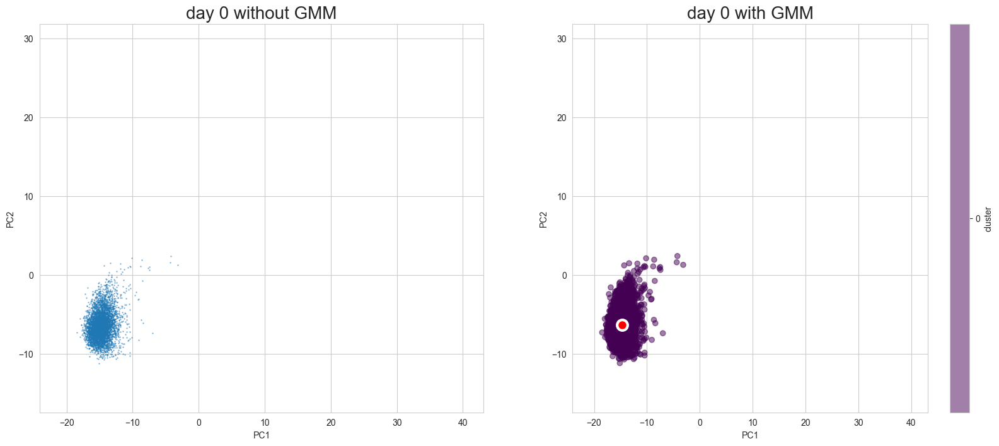

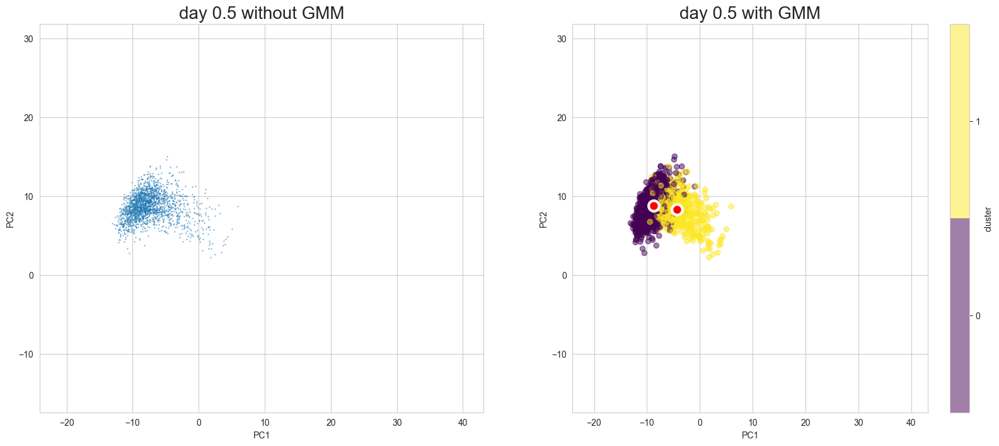

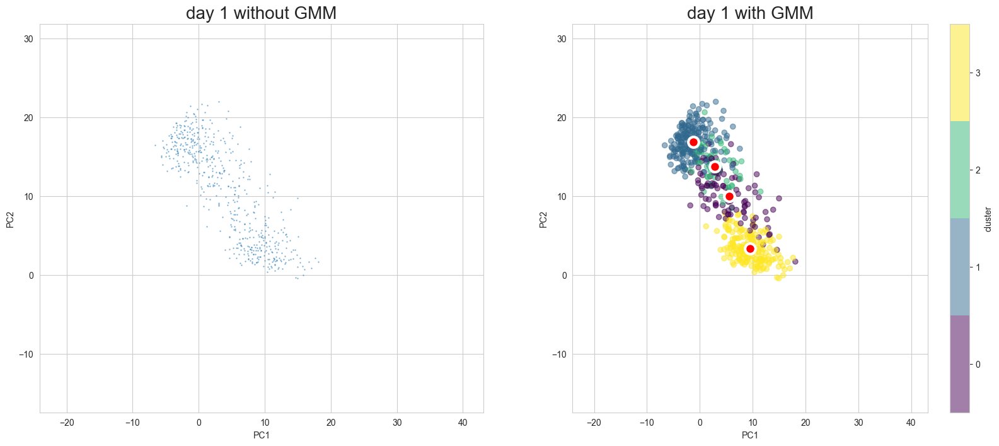

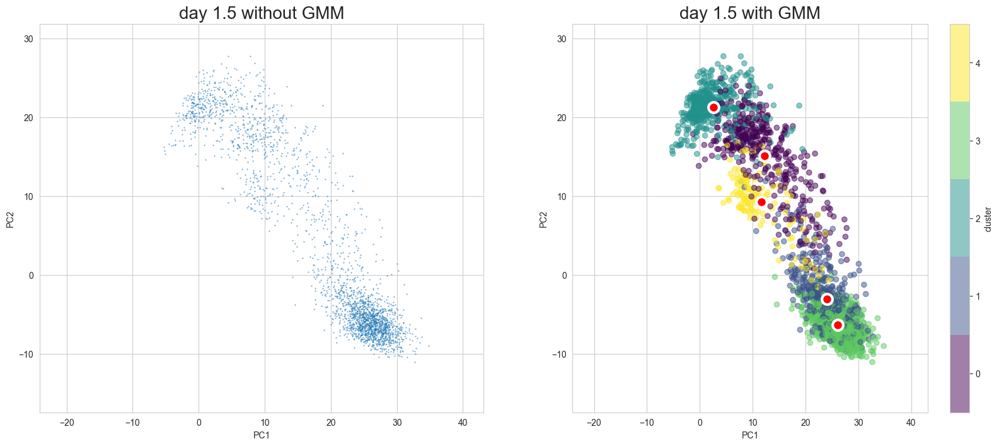

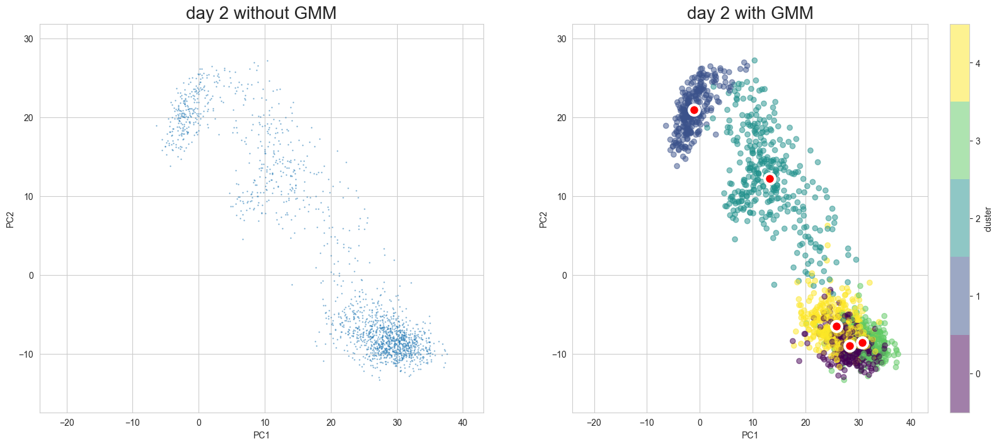

In [19]:
scegot.plot_gmm_predictions(
    plot_gmm_means=True,
    figure_titles_without_gmm=[f"{name} without GMM" for name in DAY_NAMES],
    figure_titles_with_gmm=[f"{name} with GMM" for name in DAY_NAMES],
    cmap="viridis",
)

Visualization in UMAP

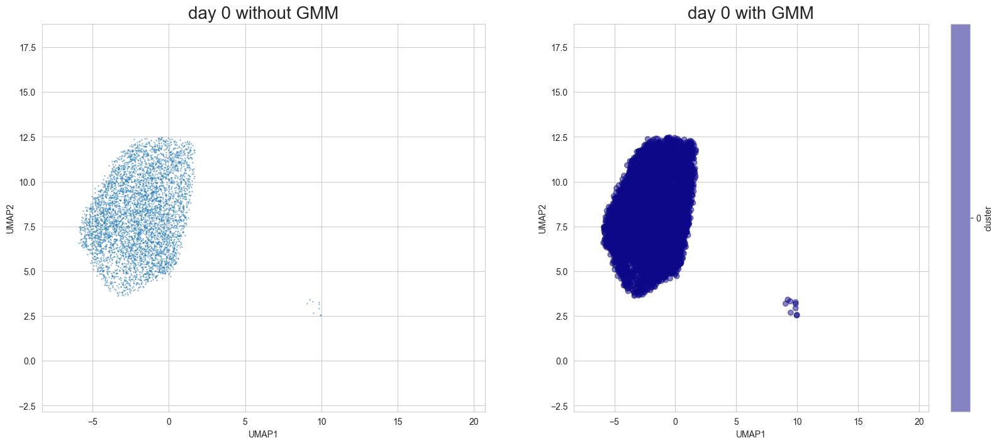

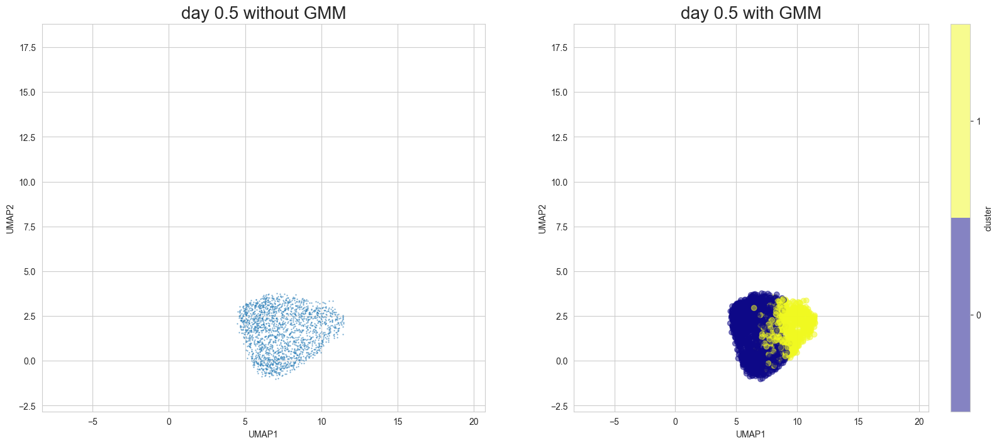

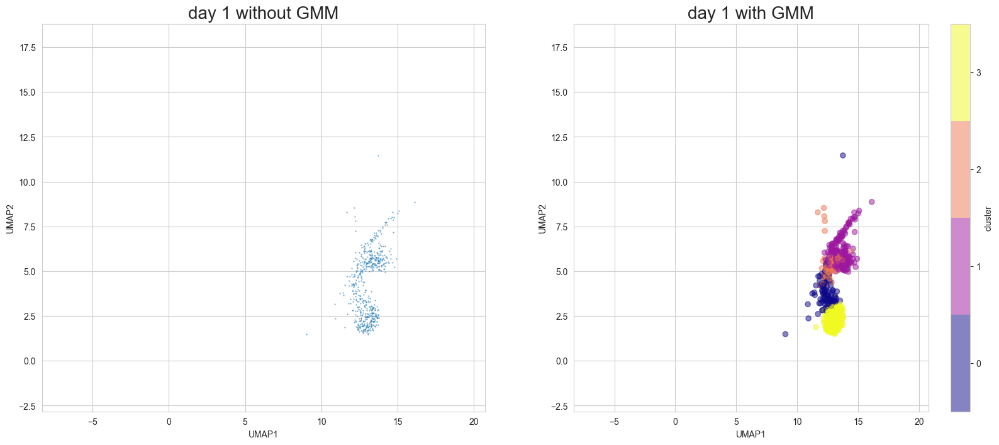

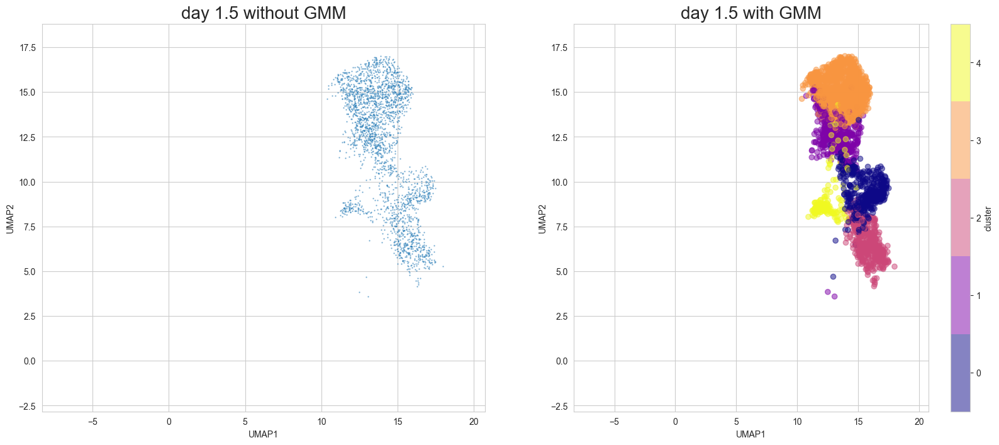

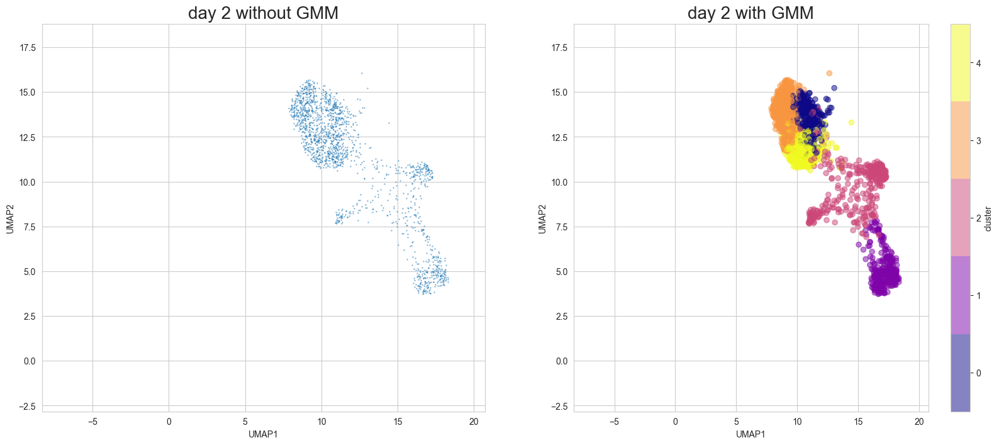

In [20]:
scegot.plot_gmm_predictions(
    mode="umap",
    figure_titles_without_gmm=[f"{name} without GMM" for name in DAY_NAMES],
    figure_titles_with_gmm=[f"{name} with GMM" for name in DAY_NAMES],
    cmap="plasma",
)

## Cell State:

You can visualize cell state in two patterns: animated and graphical

### Animation

Interpolating between day0 and day0.5...


100%|██████████| 11/11 [00:03<00:00,  2.87it/s]


Interpolating between day0.5 and day1...


100%|██████████| 10/10 [00:04<00:00,  2.13it/s]


Interpolating between day1 and day1.5...


100%|██████████| 10/10 [00:09<00:00,  1.09it/s]


Interpolating between day1.5 and day2...


100%|██████████| 10/10 [00:10<00:00,  1.05s/it]


Creating animation...


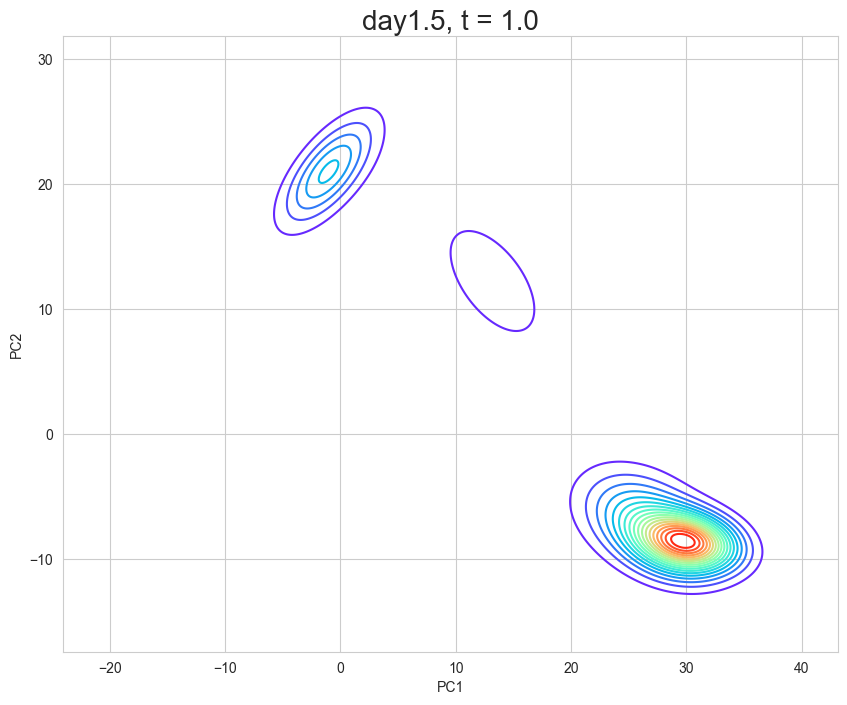

In [21]:
scegot.animate_cell_state(
    cmap="rainbow",
)

### Graph

There are two functions for visualizing cell state graphs, one is `plot_cell_state_graph()` and the other is `plot_simple_cell_state_graph()`. Both can visualize PCA and UMAP.

Before plotting the graph, call `make_cell_state_graph()` to create a graph object. At that time, cluster names must be specified as an array. Of course, you can create them manually, or there is a function called `generate_cluster_names_with_day(`) that automatically generates cluster names for you.

Since cluster names are not maintained in the scEGOT class, an array of cluster names must be passed to the function that draws the cluster names each time.

There will be other occasions where cluster names are passed in the `pathway` and `cell velocity` sections, but it is not necessary for the cluster names in those cases to match the cluster names used in this section. Therefore, the cluster name can be changed flexibly.

In [17]:
cluster_names = scegot.generate_cluster_names_with_day()
cluster_names

[['day0-0'],
 ['day0.5-0', 'day0.5-1'],
 ['day1-0', 'day1-1', 'day1-2', 'day1-3'],
 ['day1.5-0', 'day1.5-1', 'day1.5-2', 'day1.5-3', 'day1.5-4'],
 ['day2-0', 'day2-1', 'day2-2', 'day2-3', 'day2-4']]

#### In the case of  `plot_cell_state_graph()`

* Gene information is displayed in the graph.

PCA ver.

In [22]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_cell_state_graph(
    G,
    cluster_names,
    tf_gene_names,
)

UMAP ver.

In [23]:
G_umap = scegot.make_cell_state_graph(cluster_names, mode="umap")
scegot.plot_cell_state_graph(
    G_umap,
    cluster_names,
    tf_gene_names,
)

#### In the case of `plot_simple_cell_state_graph()`

* The shape of the graph can be changed by changing the layout argument.
* When `layout="hierarchy"` and `order="weight"`, the nodes are sorted in order of node weight.
  * If the order argument is not specified, the nodes are sorted in the order of their gmm labels.

PCA ver.

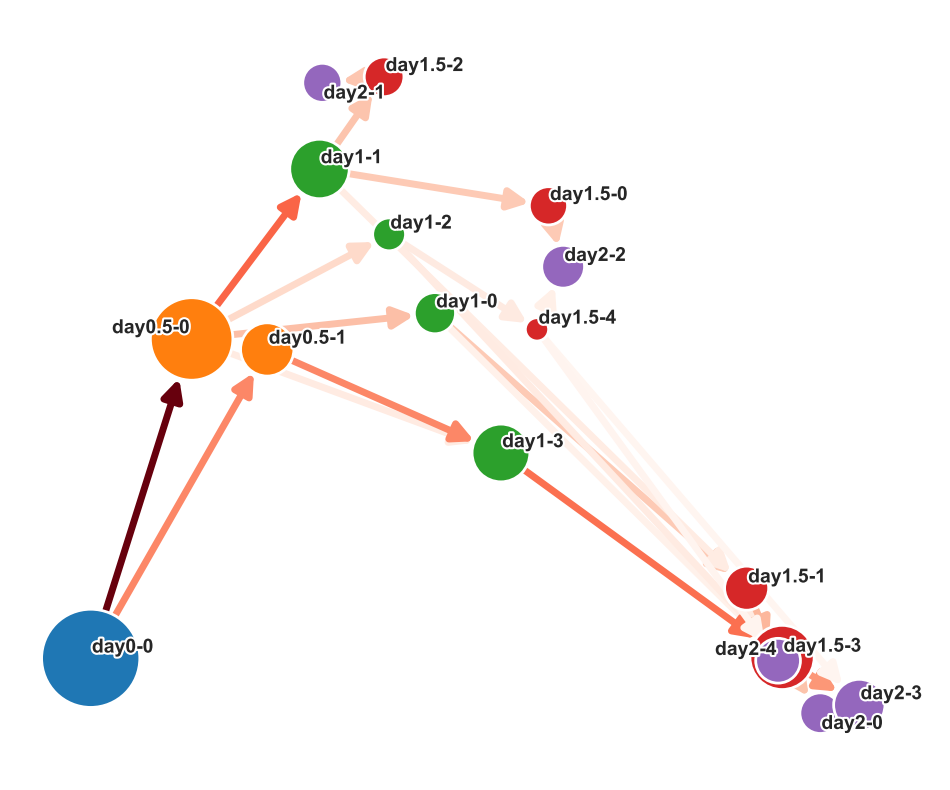

In [24]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_simple_cell_state_graph(
    G,
    layout="normal",
)

UMAP ver.

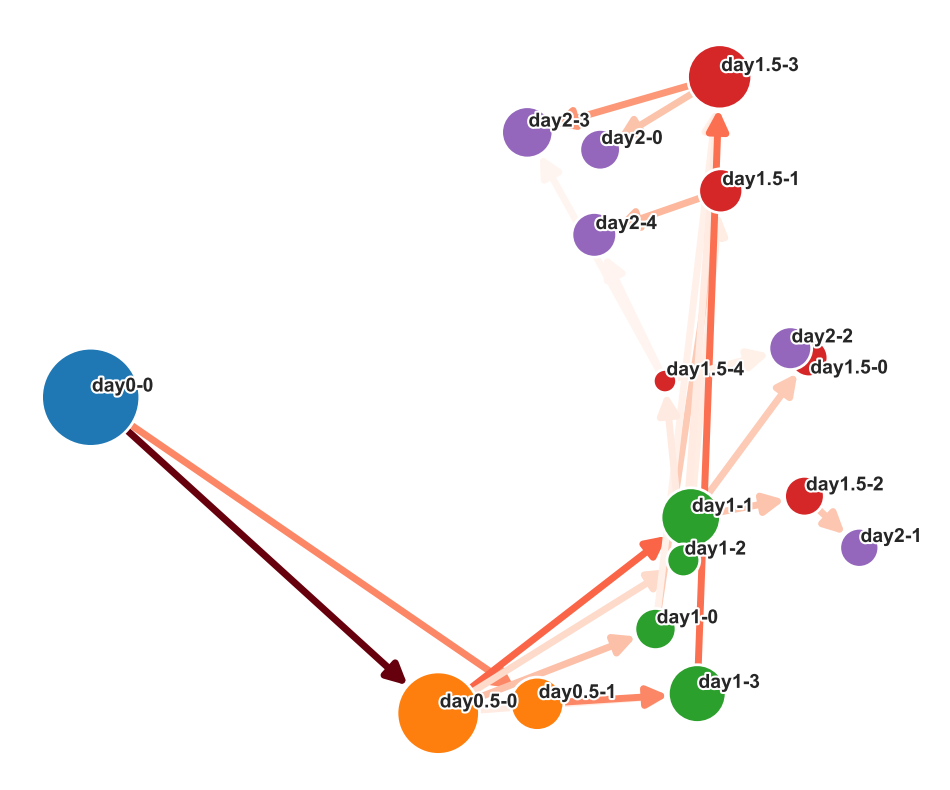

In [25]:
G_umap = scegot.make_cell_state_graph(cluster_names, mode="umap")
scegot.plot_simple_cell_state_graph(
    G_umap,
)

layout="hierarchy"

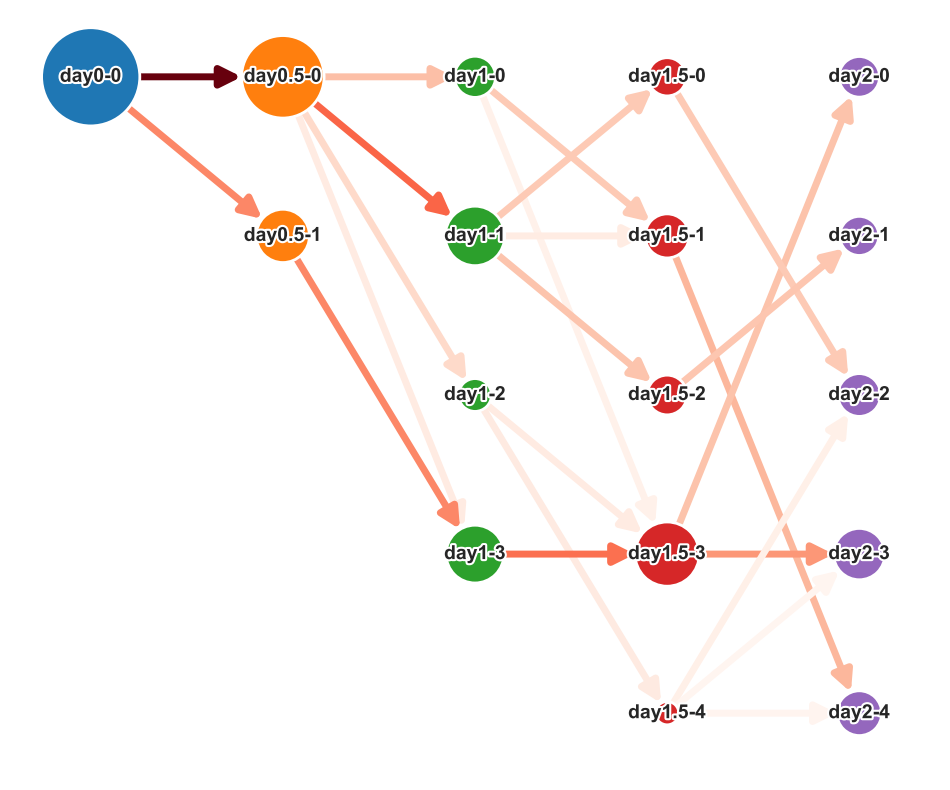

In [26]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_simple_cell_state_graph(
    G,
    layout="hierarchy",
)

layout="hierarchy" and order="weight"

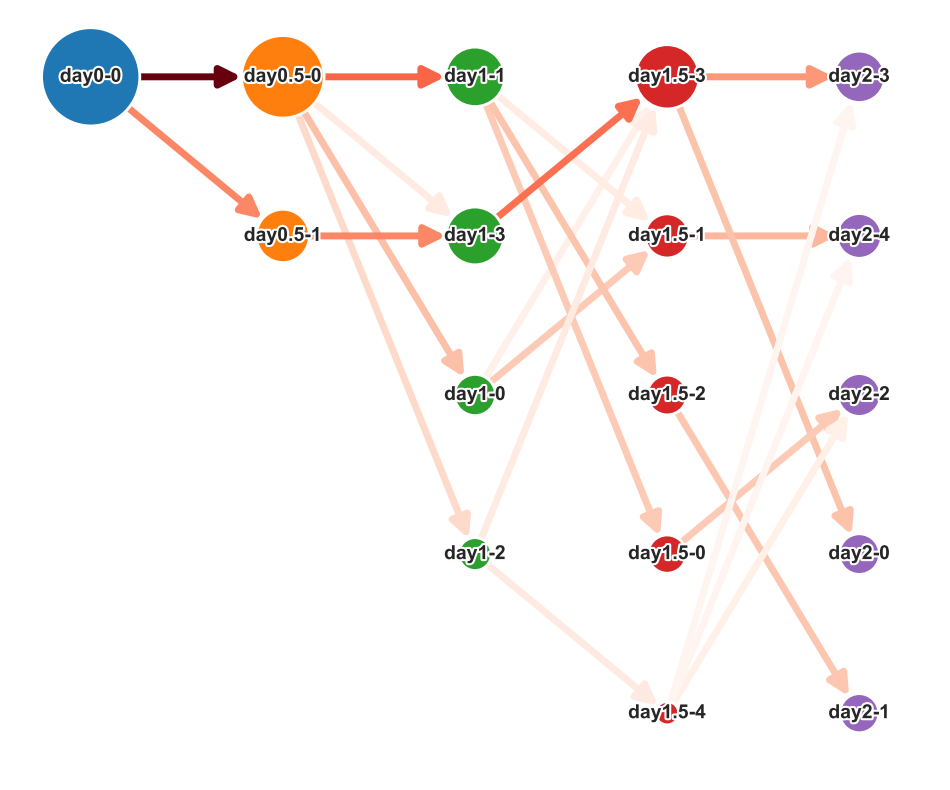

In [27]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_simple_cell_state_graph(
    G,
    layout="hierarchy",
    order="weight",
)

## Fold Change:

You can see the fold change between the two clusters.

In [28]:
cluster1 = "day0.5-0"
cluster2 = "day0.5-1"
scegot.plot_fold_change(
    cluster_names,
    tf_gene_names,
    cluster1,
    cluster2,
    threshold=1.0,
)

## Pathway:

Visualize the transition of expression levels of `selected_genes` in the clusters specified by `pathway_names`.

In [29]:
pathway_names = [
    "day0-0",
    "day0.5-1",
    "day1-1",
    "day1.5-4",
    "day2-2",
]
selected_genes = ["NANOG", "SOX17", "TFAP2C", "NKX1-2"]
scegot.plot_pathway_gene_expressions(
    cluster_names,
    tf_gene_names,
    pathway_names,
    selected_genes,
)

## Features of single gene:

You can also plot only the features of a single gene.

### 2D

PCA ver.

In [30]:
gene_name = "NKX1-2"
scegot.plot_pathway_single_gene_2d(
    gene_name,
)

UMAP ver.

In [31]:
gene_name = "NKX1-2"
scegot.plot_pathway_single_gene_2d(gene_name, mode="umap")

### 3D

In [32]:
gene_name = "NKX1-2"
scegot.plot_pathway_single_gene_3d(
    gene_name,
)

## Interpolation:

### Accuracy check of interpolation

For each of PCA and UMAP, interpolated and correct data can be compared. Also, source and target can be toggled on and off.

PCA ver.

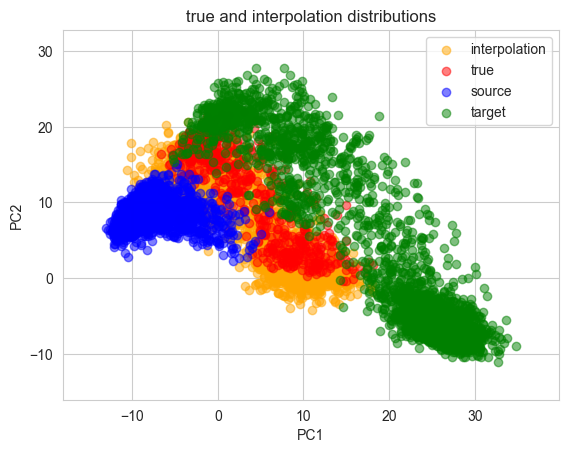

In [33]:
scegot.plot_true_and_interpolation_distributions(
    2,
    alpha_true=0.5,
)

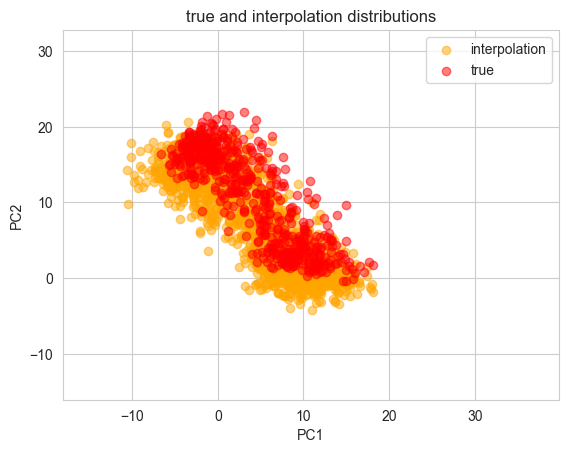

In [34]:
scegot.plot_true_and_interpolation_distributions(
    2,
    plot_source_and_target=False,
    alpha_true=0.5,
)

UMAP ver.

Transforming interpolated data with UMAP...


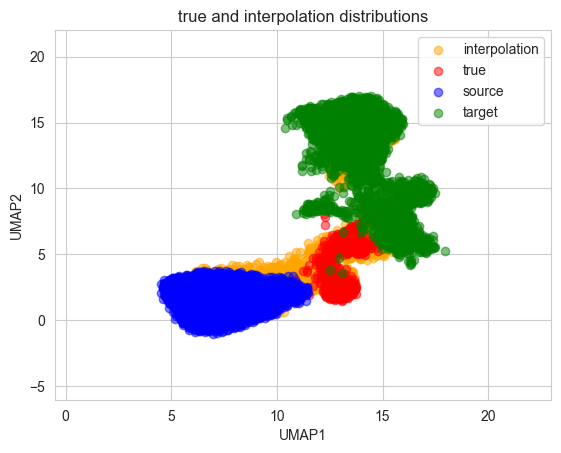

In [35]:
scegot.plot_true_and_interpolation_distributions(
    2,
    alpha_true=0.5,
    mode="umap",
)

Transforming interpolated data with UMAP...


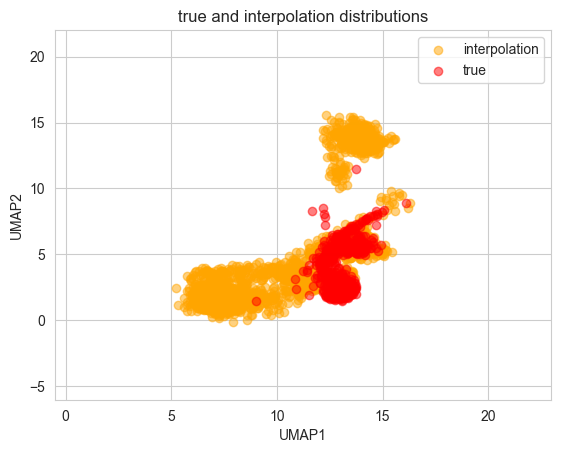

In [36]:
scegot.plot_true_and_interpolation_distributions(
    2,
    plot_source_and_target=False,
    alpha_true=0.5,
    mode="umap",
)

### Video visualization of feature changes in a single gene

PCA ver.

Interpolating between day0 and day0.5...


  0%|          | 0/11 [00:00<?, ?it/s]

100%|██████████| 11/11 [00:00<00:00, 14.16it/s]


Interpolating between day0.5 and day1...


100%|██████████| 10/10 [00:00<00:00, 11.10it/s]


Interpolating between day1 and day1.5...


100%|██████████| 10/10 [00:01<00:00,  6.84it/s]


Interpolating between day1.5 and day2...


100%|██████████| 10/10 [00:01<00:00,  7.19it/s]


Creating animation...


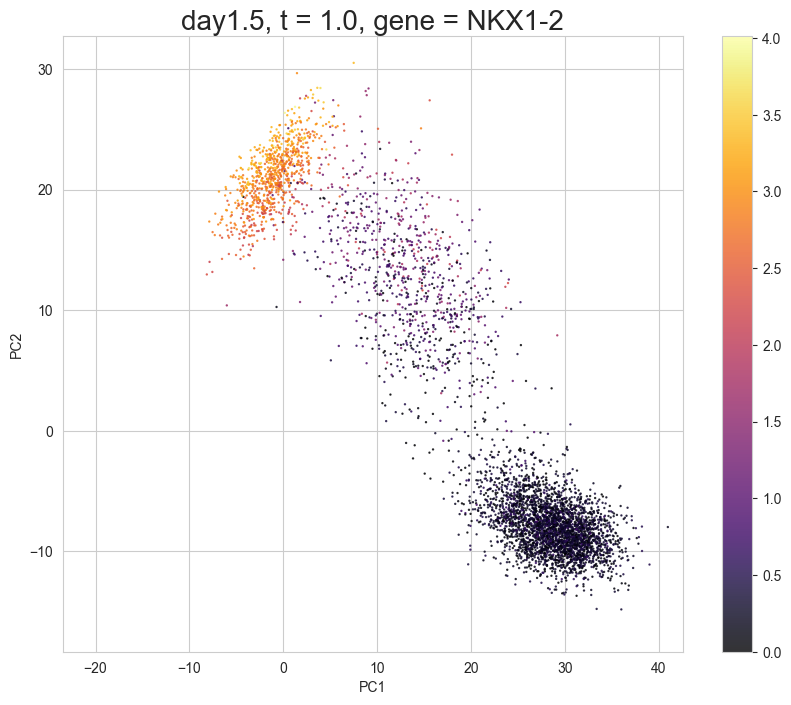

In [37]:
target_gene = "NKX1-2"
scegot.animate_interpolation(
    target_gene,
    interpolate_interval=11,
    cmap="inferno",
)

UMAP ver.

Interpolating between day0 and day0.5...


100%|██████████| 11/11 [05:19<00:00, 29.06s/it]


Interpolating between day0.5 and day1...


100%|██████████| 10/10 [04:40<00:00, 28.03s/it]


Interpolating between day1 and day1.5...


100%|██████████| 10/10 [04:40<00:00, 28.04s/it]


Interpolating between day1.5 and day2...


100%|██████████| 10/10 [04:44<00:00, 28.47s/it]


Creating animation...


CPU times: user 20min 10s, sys: 23 s, total: 20min 33s
Wall time: 19min 29s


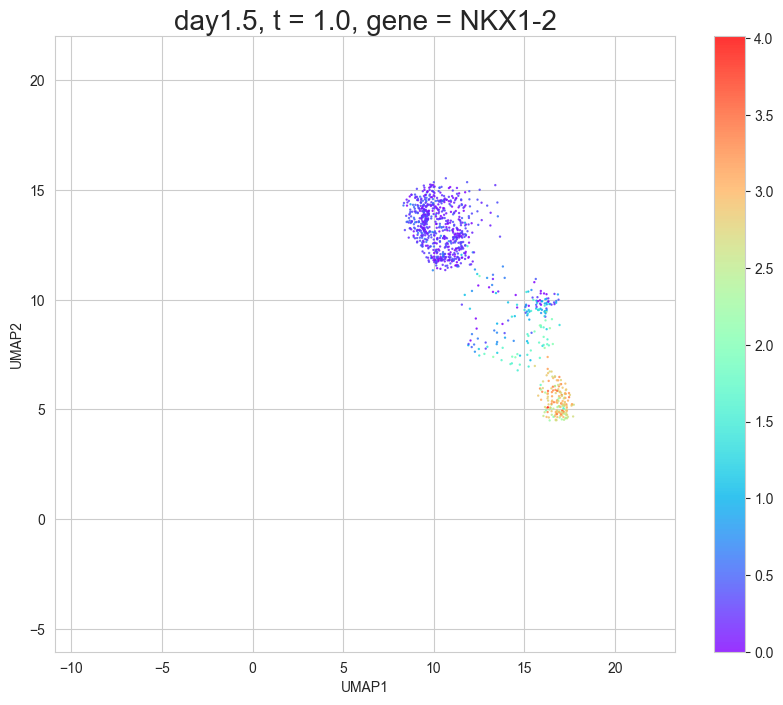

In [38]:
%%time
target_gene = "NKX1-2"
scegot.animate_interpolation(
    target_gene,
    interpolate_interval=11,
    n_samples=1000,
    mode="umap",
)

## Cell velocity:

### Plotting cell velocity

After the velocity is calculated using `calculate_cell_velocities()`, visualize it with `plot_cell_velocity()`. Both PCA and UMAP are supported.

PCA ver.

In [39]:
velocities = scegot.calculate_cell_velocities()

Calculating cell velocities between each day...


100%|██████████| 4/4 [00:03<00:00,  1.05it/s]


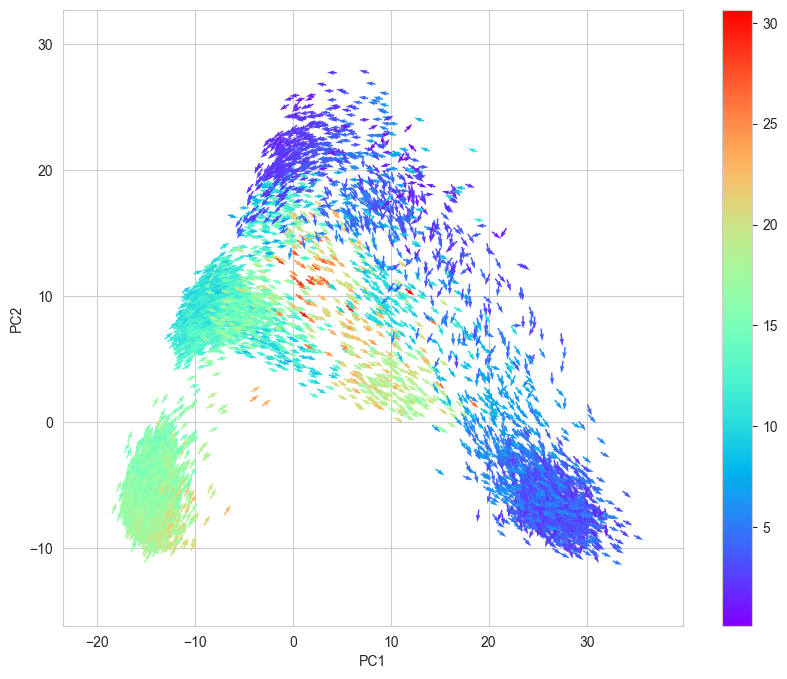

In [40]:
scegot.plot_cell_velocity(
    velocities,
    cmap="rainbow",
)

UMAP ver.

In [41]:
%%time
velocities_umap = scegot.calculate_cell_velocities(mode="umap")

Calculating cell velocities between each day...


100%|██████████| 4/4 [04:41<00:00, 70.34s/it] 

CPU times: user 5min, sys: 3.34 s, total: 5min 3s
Wall time: 4min 41s


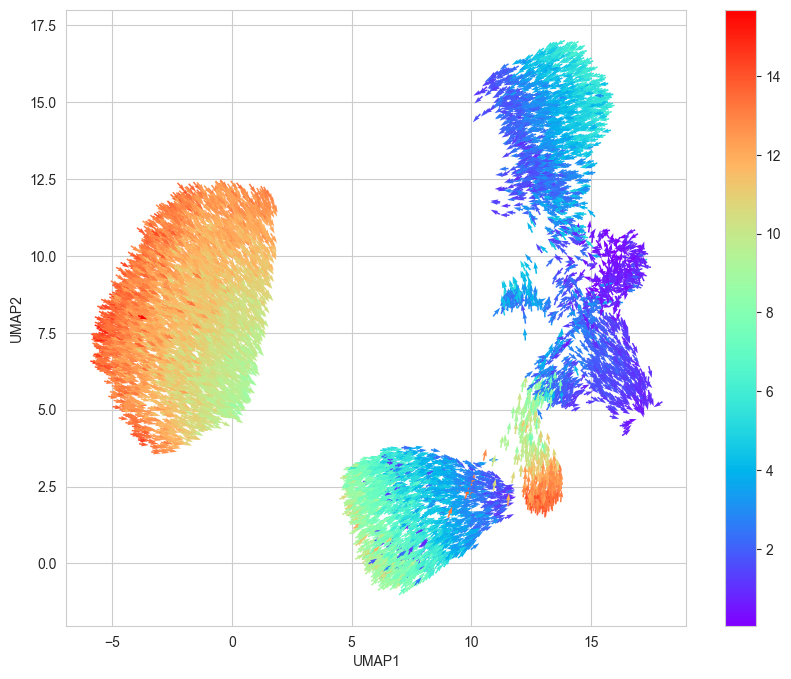

CPU times: user 619 ms, sys: 7.39 ms, total: 626 ms
Wall time: 231 ms


In [43]:
%%time
scegot.plot_cell_velocity(
    velocities_umap,
    mode="umap",
    cmap="rainbow",
)

### Interpolation of cell velocity

You can color the clusters and / or the streams.

PCA ver.

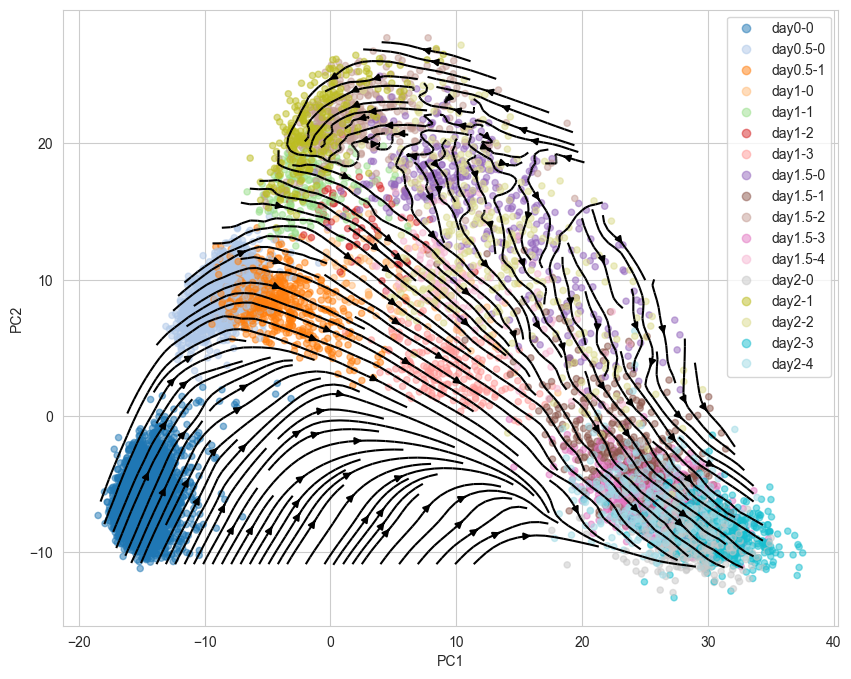

In [44]:
scegot.plot_interpolation_of_cell_velocity(
    velocities,
    cluster_names=list(itertools.chain.from_iterable(cluster_names)),
    cmap="tab20",
)

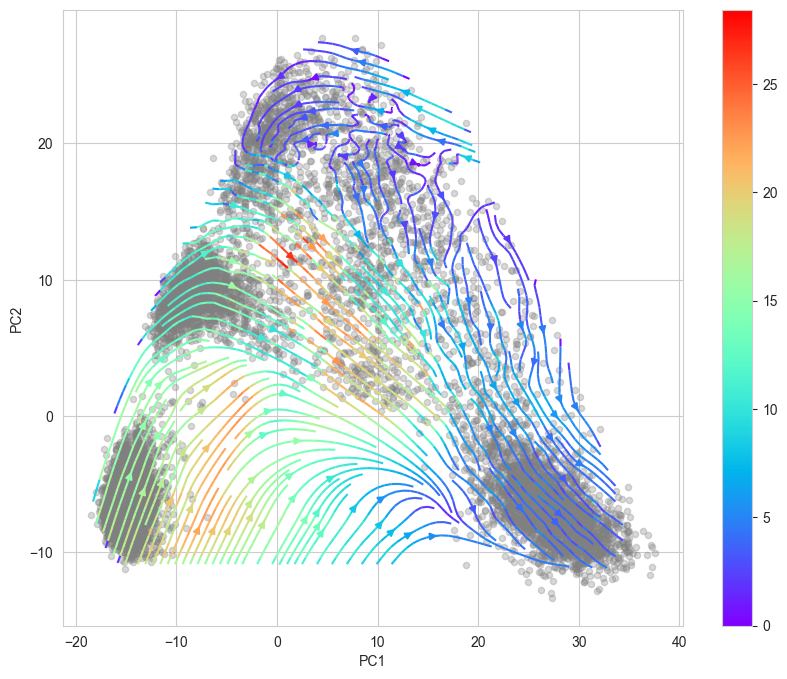

In [45]:
scegot.plot_interpolation_of_cell_velocity(
    velocities,
    color_streams=True,
    color_points=None,
    cmap="rainbow",
)

UMAP ver.

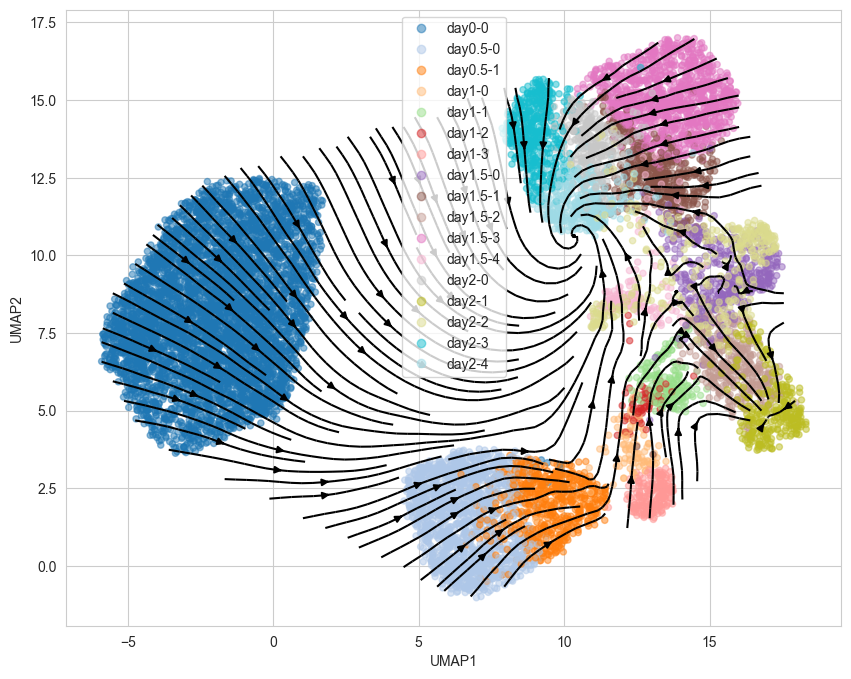

In [48]:
scegot.plot_interpolation_of_cell_velocity(
    velocities_umap,
    mode="umap",
    cluster_names=list(itertools.chain.from_iterable(cluster_names)),
    cmap="tab20",
)

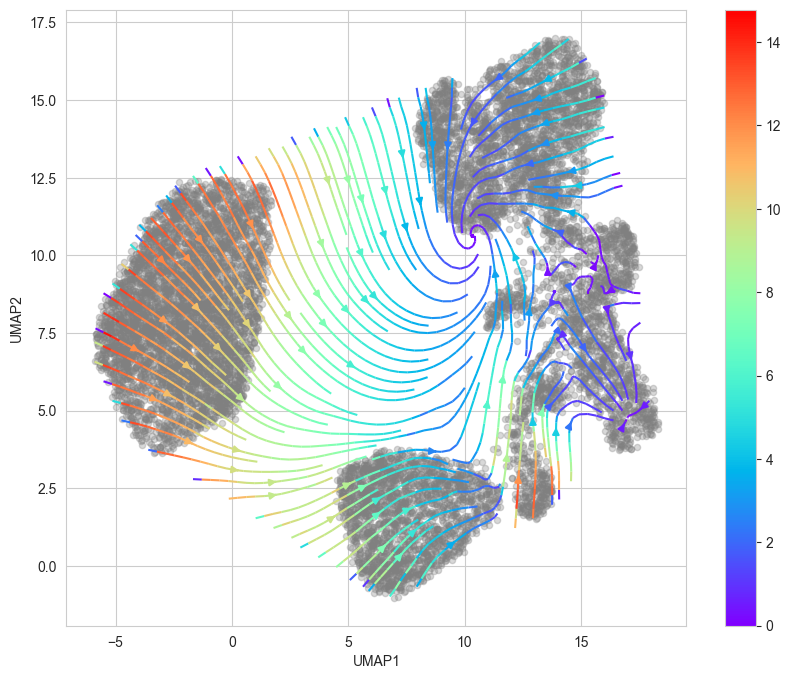

In [49]:
scegot.plot_interpolation_of_cell_velocity(
    velocities_umap,
    mode="umap",
    color_streams=True,
    color_points=None,
    cmap="rainbow",
)

## Gene regulatory network:

You can visualize the Gene regulatory network between genes specified in `selected_genes`.

In [50]:
%%time
GRNs, ridgeCVs = scegot.calculate_grns()

Calculating GRNs between each day...


100%|██████████| 4/4 [00:11<00:00,  2.83s/it]

CPU times: user 1min 7s, sys: 948 ms, total: 1min 8s
Wall time: 11.3 s


alpha = 8.858667904100823


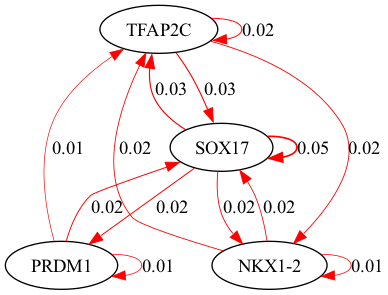

alpha = 23.357214690901213


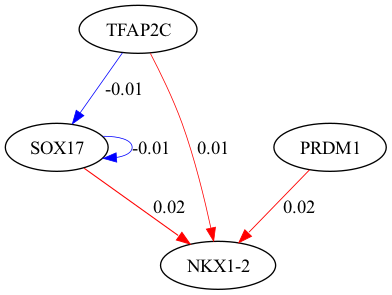

alpha = 23.357214690901213


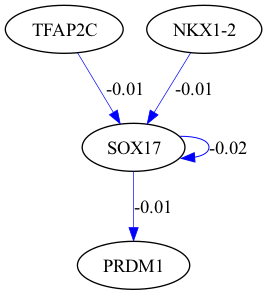

alpha = 100.0


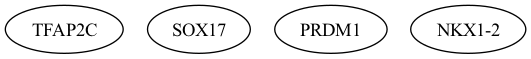

In [51]:
selected_genes = ["TFAP2C", "SOX17", "PRDM1", "NKX1-2"]
scegot.plot_grn_graph(
    GRNs,
    ridgeCVs,
    selected_genes,
)

You can also specify the clusters to use.

In [52]:
%%time
cluster_set_PGC = [[0, 0], [1, 0], [2, 0], [3, 0]]
GRNs_cluster, ridgeCVs_cluster = scegot.calculate_grns(
    selected_clusters=cluster_set_PGC
)

Calculating GRNs between each day...


100%|██████████| 4/4 [00:04<00:00,  1.13s/it]

CPU times: user 29.6 s, sys: 882 ms, total: 30.5 s
Wall time: 4.55 s


alpha = 8.858667904100823


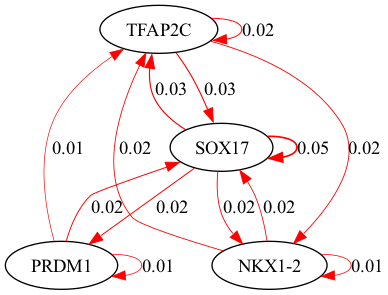

alpha = 5.455594781168514


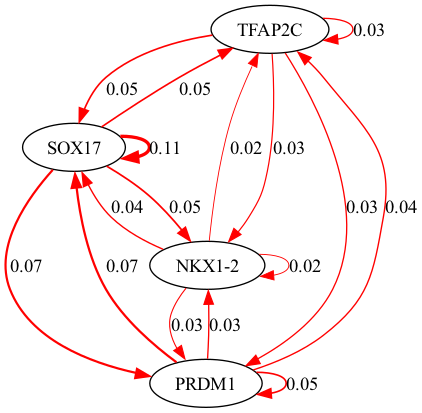

alpha = 0.7847599703514611


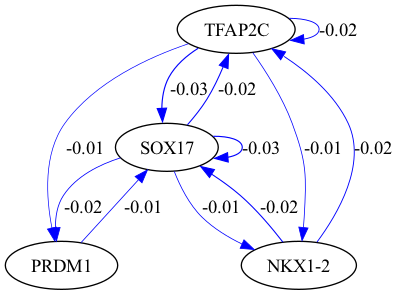

alpha = 14.38449888287663


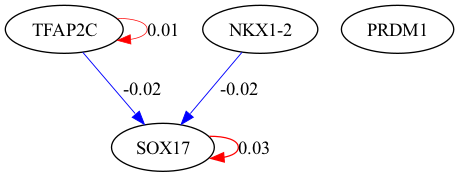

In [53]:
selected_genes = ["TFAP2C", "SOX17", "PRDM1", "NKX1-2"]
scegot.plot_grn_graph(
    GRNs_cluster,
    ridgeCVs_cluster,
    selected_genes,
)

## Waddington Landscape:

Both PCA and UMAP are supported.

In [54]:
%%time
Wpotential, F_all = scegot.calculate_waddington_potential()

Calculating F between each day...


100%|██████████| 4/4 [01:04<00:00, 16.22s/it]


Applying knn ...
Computing kernel ...
CPU times: user 7min 3s, sys: 12.7 s, total: 7min 15s
Wall time: 1min 7s


In [71]:
%%time
Wpotential_umap, F_all_umap = scegot.calculate_waddington_potential(knn_mode="umap")

Calculating F between each day...


100%|██████████| 4/4 [01:05<00:00, 16.37s/it]


Applying knn ...
Computing kernel ...
CPU times: user 6min 55s, sys: 16 s, total: 7min 11s
Wall time: 1min 7s


Plots Waddington potential in 3 dimensions. You can also select a single gene and color it by expression level.

PCA ver.

In [67]:
scegot.plot_waddington_potential(Wpotential)

In [68]:
gene_name = "NKX1-2"
scegot.plot_waddington_potential(
    Wpotential,
    gene_name,
)

UMAP ver.

In [72]:
scegot.plot_waddington_potential(Wpotential_umap)

In [73]:
gene_name = "NKX1-2"
scegot.plot_waddington_potential(
    Wpotential_umap,
    gene_name,
)

You can also display a landscape instead of a plot of points.

PCA ver.

In [74]:
scegot.plot_waddington_potential_surface(
    Wpotential,
)

UMAP ver.

In [75]:
scegot.plot_waddington_potential_surface(
    Wpotential_umap,
)